In [1]:
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
import glob

In [2]:
# the notebook will reload external python modules;
%load_ext autoreload
%autoreload 2

In [3]:
#make matplotlib figures appear inline in the notebook
#rather than in a new window.
%matplotlib inline
#sns.set()
# set default size of plots
plt.rcParams['figure.figsize'] = (12.0, 10.0) 
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20


#print OpenCV version
print ("OpenCV Version : %s " % cv2.__version__)

OpenCV Version : 3.3.1 


In [4]:
def calibration_from_vid(vid_file=None,
                           frame_step=20,
                           pattern_size=(9,6),
                           square_size=1.0,
                           criteria=(cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_COUNT, 30, 0.001),
                           debug=False):
    
    """[This function provides a calibration matrix extracted from a calibration video]
    Keyword Arguments:
        vid_file {[type]} -- [description] (default: {None})
        frame_step {int} -- [description] (default: {20})
        patern_size {tuple} -- [description] (default: {(9,6)})
        square_size {float} -- [description] (default: {1.0})
        criteria {tuple} -- [description] (default: {(cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)})
        debug {boolean} -- [description] (default: {False})
    """       
    
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((np.prod(pattern_size), 3), np.float32)       
    objp[:,:2] = np.indices(pattern_size).T.reshape(-1, 2)
    objp *= square_size
    
    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane.
    num_pat_found = 0 # number of images where the pattern has been found
    num_images = 0 # number of images
    
    #source video
    print('Calibrating video: ' + vid_file + ' ...')
    video_capture = cv2.VideoCapture(vid_file)
    
    retval = True    
    i=-1
    while retval:
        #extracting frame
        i+=1
        retval, img = video_capture.read()
        if not retval:
            print('video capture failed!')
            break
            
        #read at each frame_step    
        if i % frame_step != 0:
            continue
        
        #print('Searching for chessboard in frame ' + str(i) + '...')
        
        #TODO: Resize the image to improve time
        #Resize    
        #img = cv2.resize(img, None, fx=.4, fy=.4, interpolation = cv2.INTER_CUBIC)
        
        #convert to grayscale
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)  
        (w,h) = gray.shape
        
        # Find the chess board corners    
        ret, corners = cv2.findChessboardCorners(gray, pattern_size)
        
        # If found, add object points, image points (after refining them)
        if ret == True:
            #update number of images where the pattern has been found
            num_pat_found += 1
            
            cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
            
            objpoints.append(objp)        
            imgpoints.append(corners)
            
            if debug is True:
                print('Searching for chessboard in frame ' + str(i) + '...')
                # Draw and display the corners
                img = cv2.drawChessboardCorners(img, pattern_size, corners,ret)
                plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.show()
    
    #Camera calibration
    print('computing cam params...')
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,
                                                   imgpoints,
                                                   (w,h),
                                                   None,
                                                   None)
    print('Done!')
    return ret, mtx, dist, rvecs, tvecs
    

## Testing Function Debug mode

Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00964.MP4 ...
Searching for chessboard in frame 0...


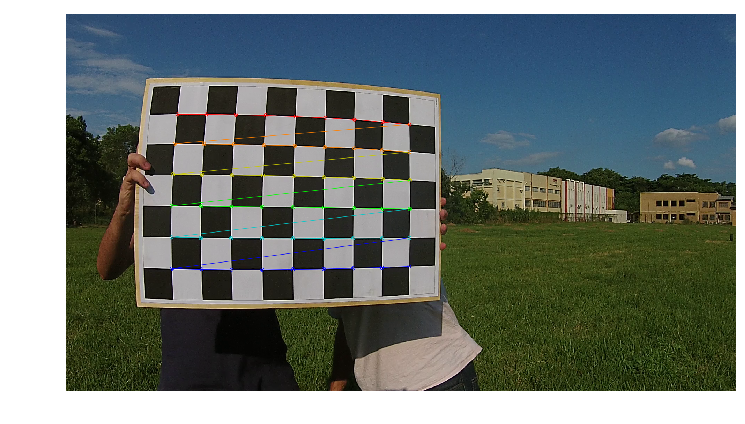

Searching for chessboard in frame 30...


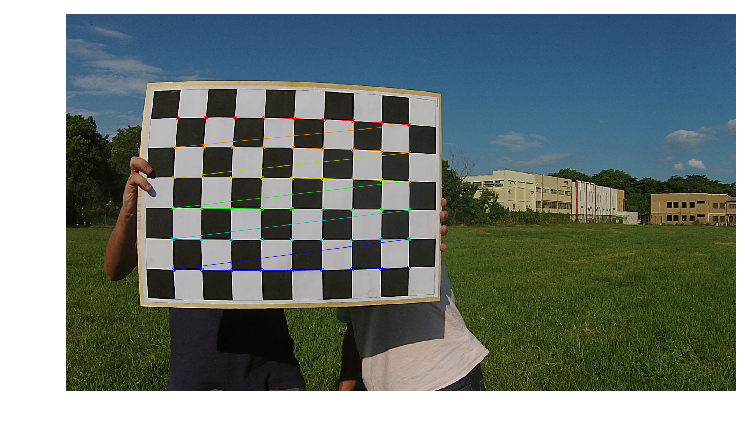

Searching for chessboard in frame 60...


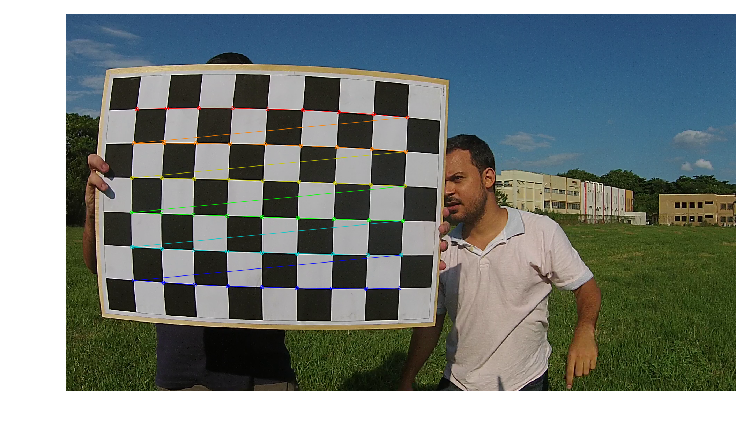

Searching for chessboard in frame 90...


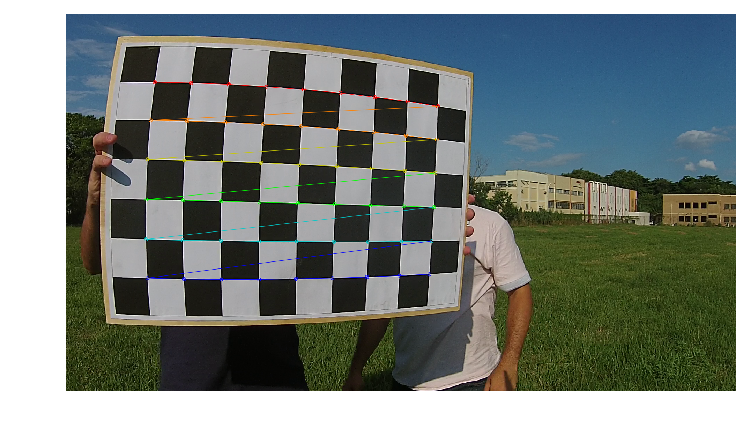

Searching for chessboard in frame 120...


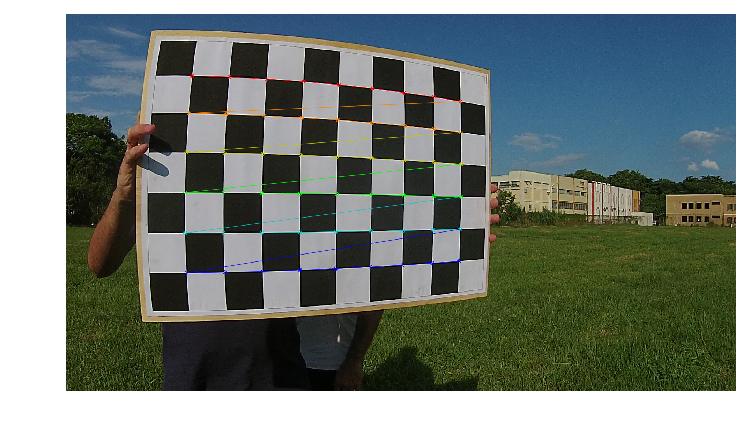

Searching for chessboard in frame 150...


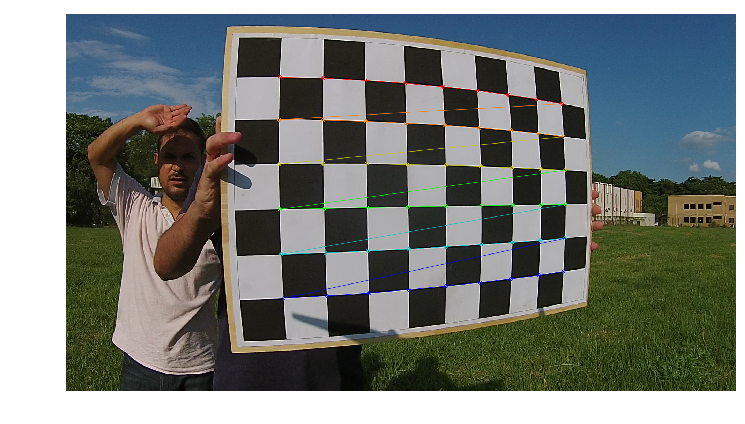

Searching for chessboard in frame 180...


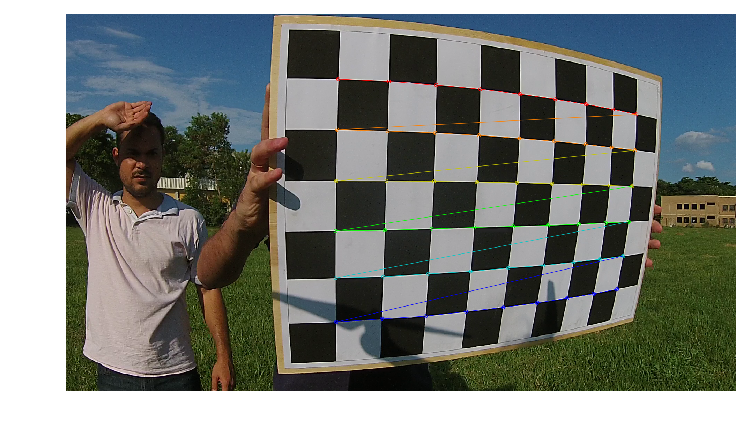

Searching for chessboard in frame 210...


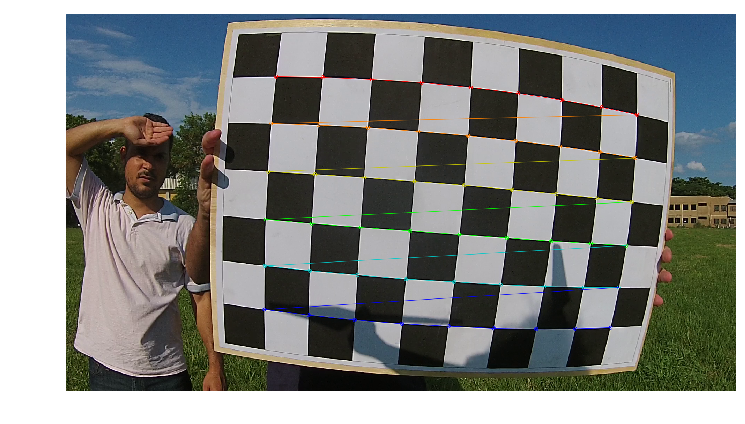

Searching for chessboard in frame 240...


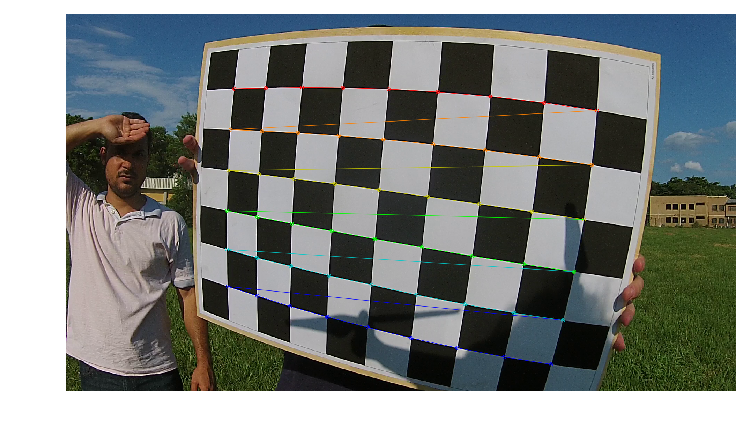

Searching for chessboard in frame 270...


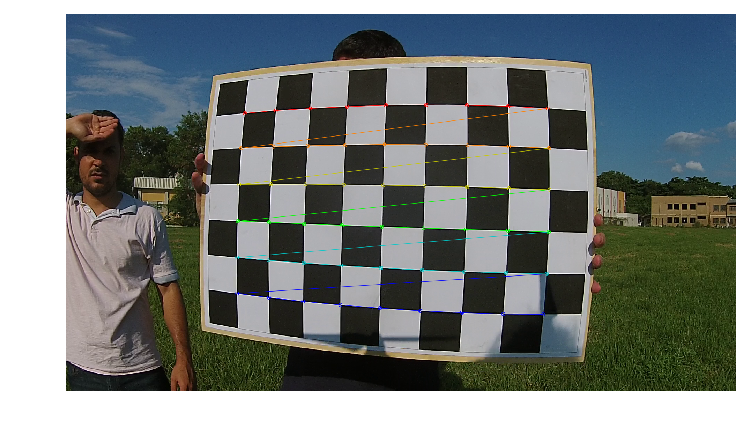

Searching for chessboard in frame 300...


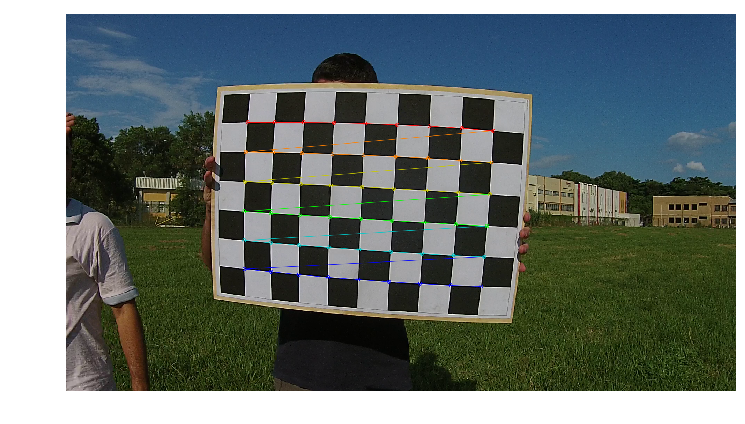

Searching for chessboard in frame 330...


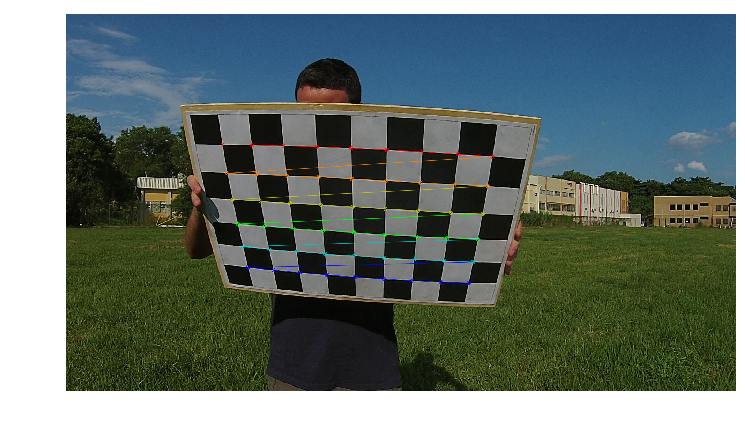

Searching for chessboard in frame 360...


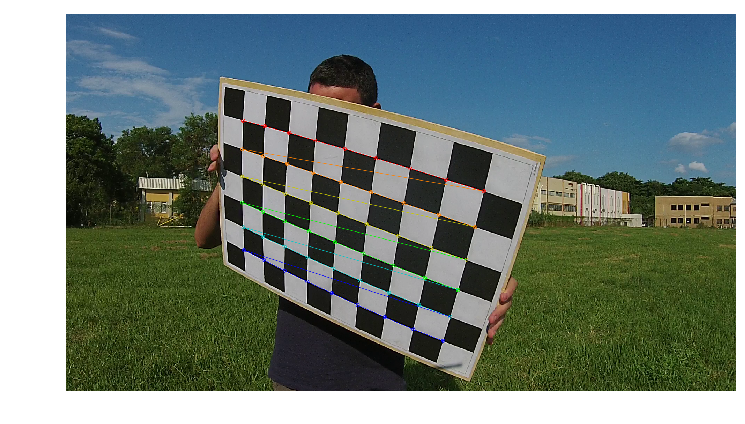

Searching for chessboard in frame 390...


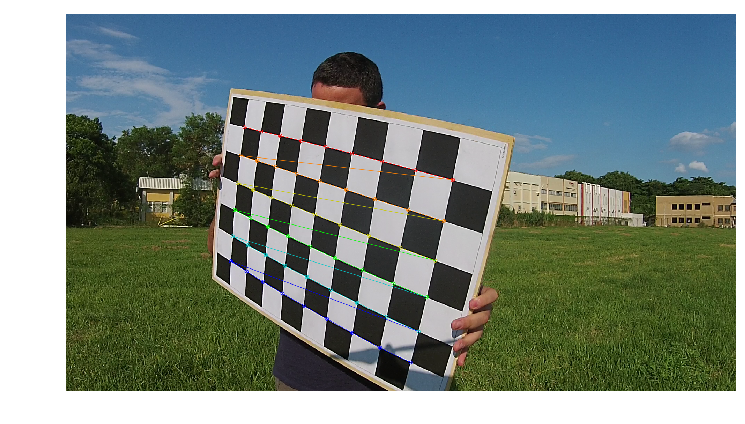

Searching for chessboard in frame 420...


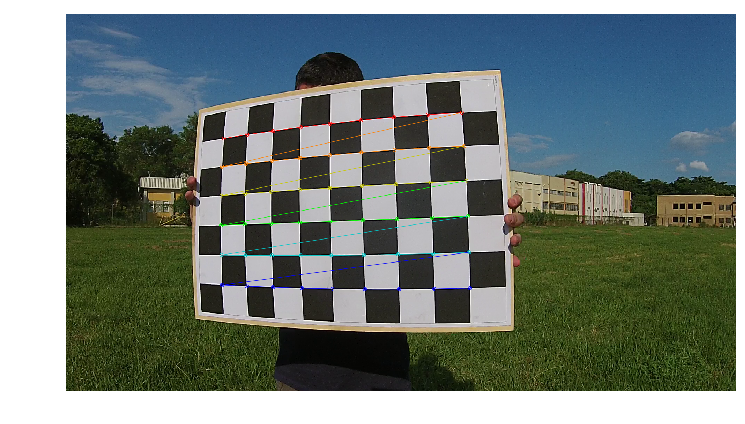

Searching for chessboard in frame 450...


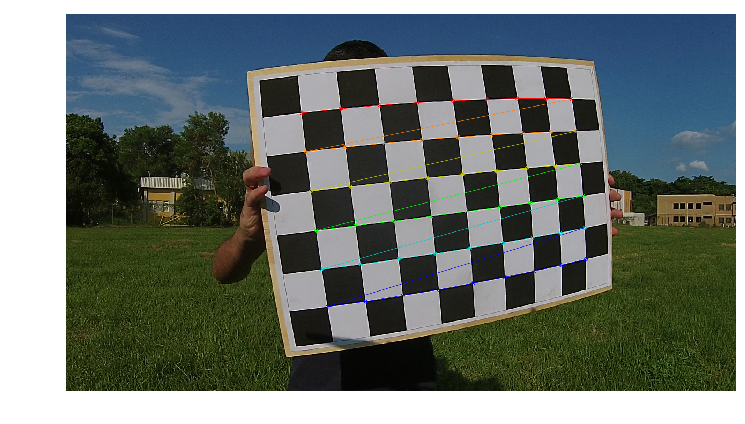

Searching for chessboard in frame 480...


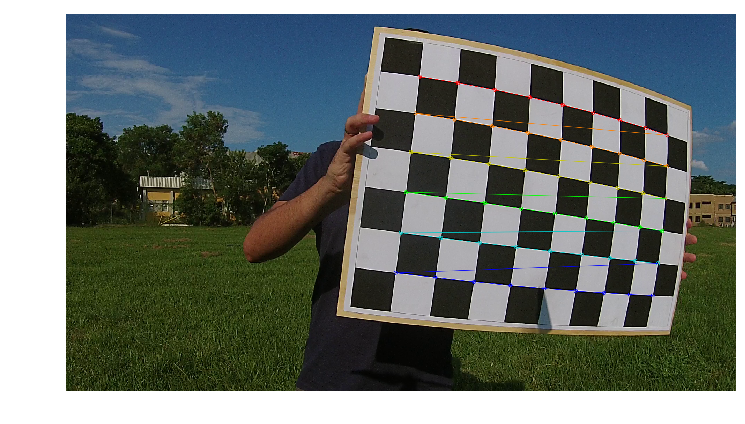

Searching for chessboard in frame 510...


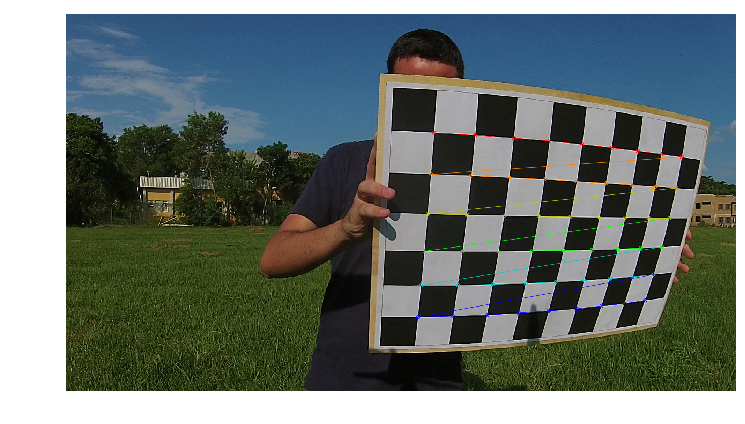

Searching for chessboard in frame 540...


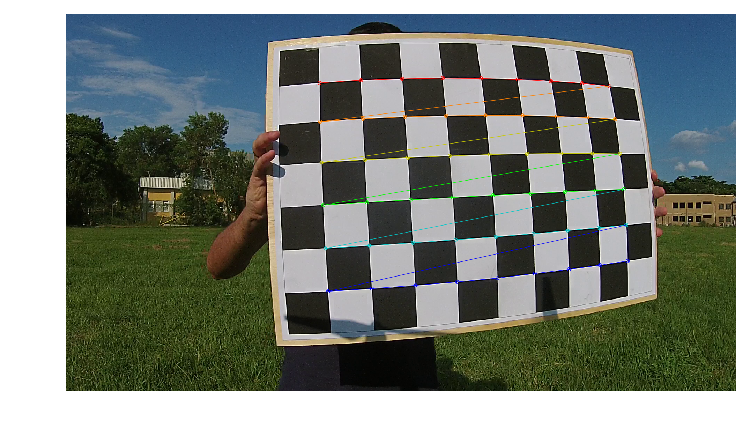

Searching for chessboard in frame 570...


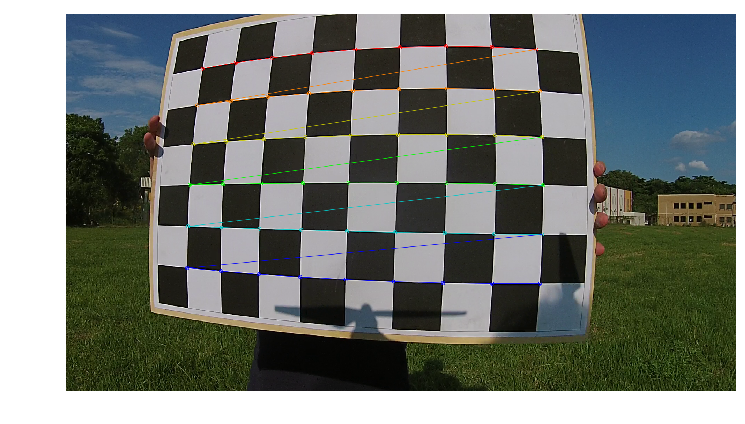

Searching for chessboard in frame 600...


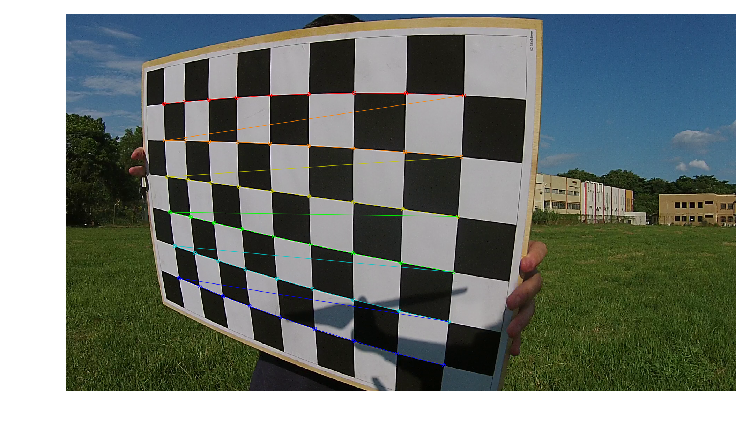

Searching for chessboard in frame 630...


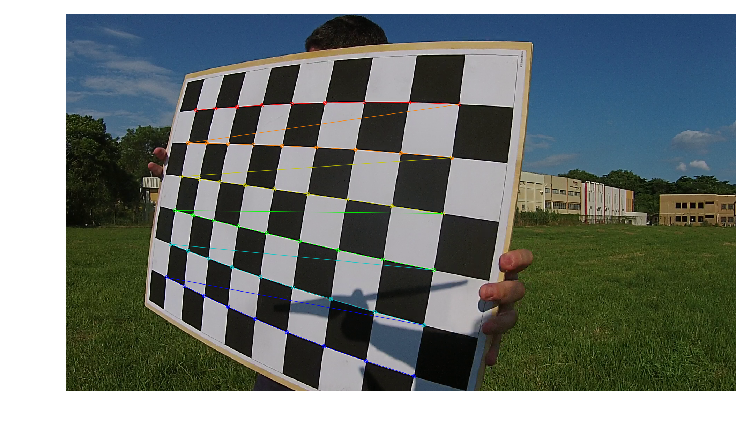

Searching for chessboard in frame 660...


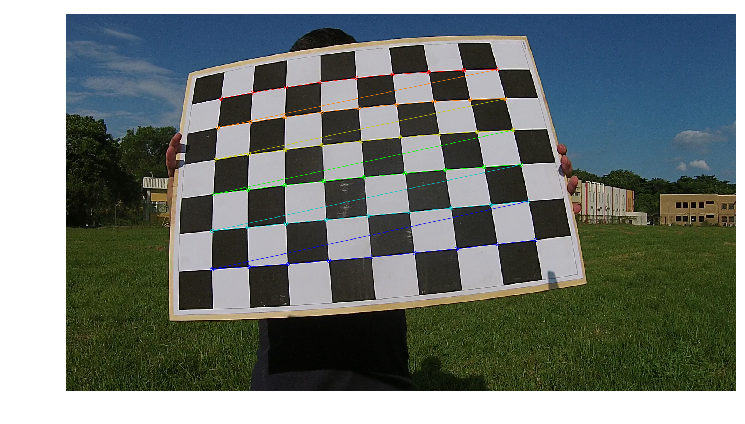

Searching for chessboard in frame 690...


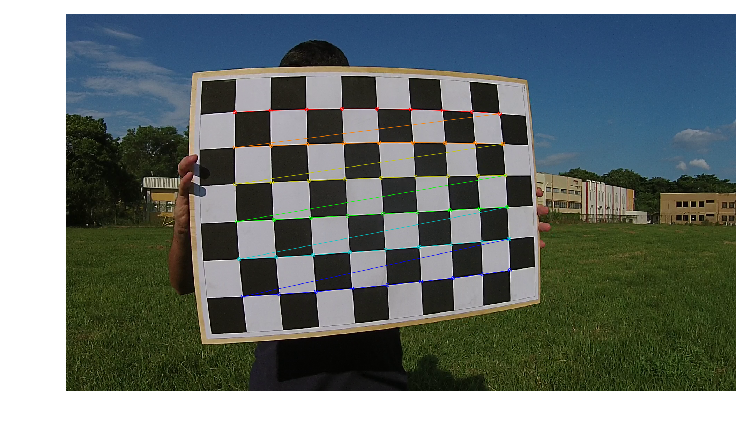

Searching for chessboard in frame 780...


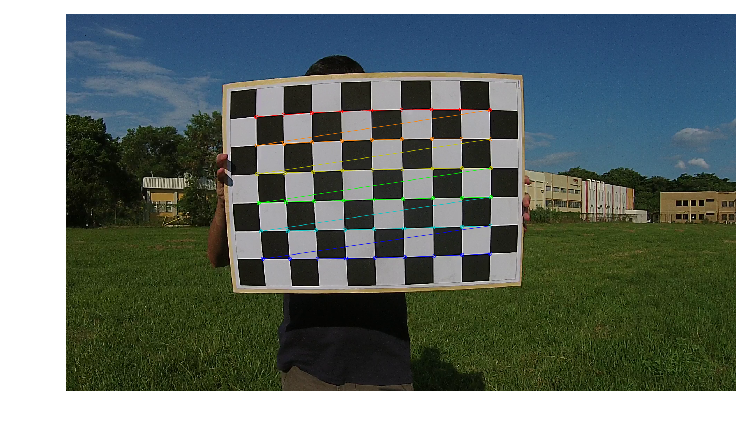

Searching for chessboard in frame 810...


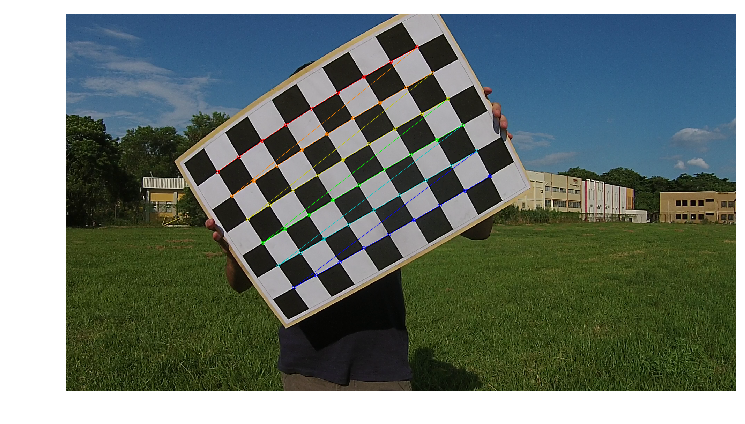

Searching for chessboard in frame 840...


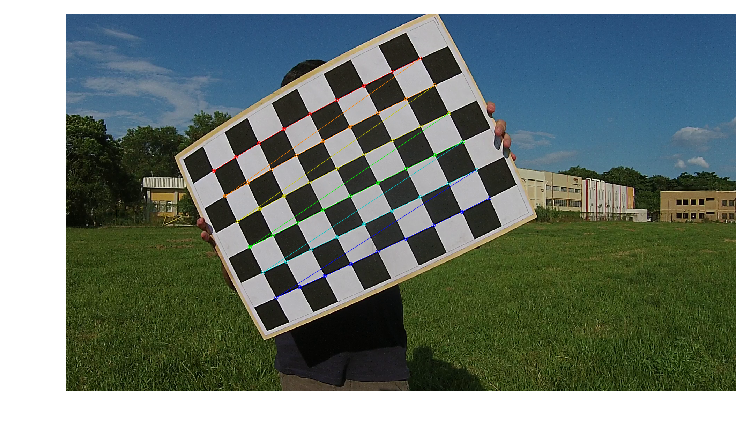

Searching for chessboard in frame 870...


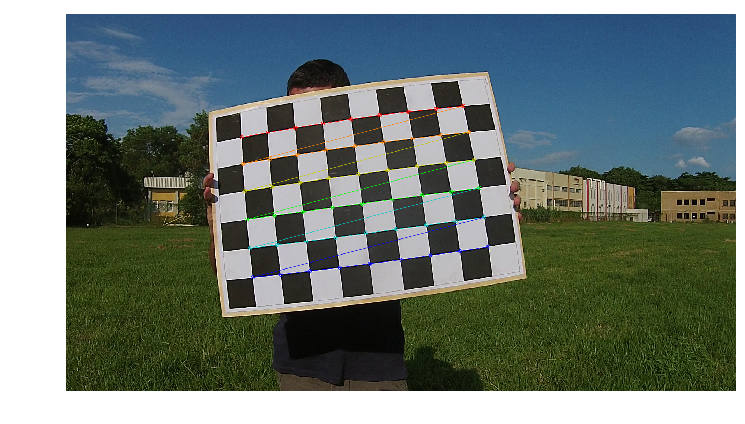

Searching for chessboard in frame 900...


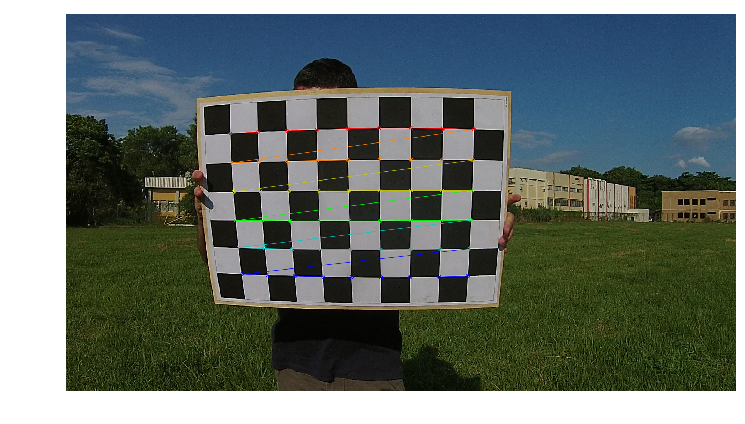

Searching for chessboard in frame 930...


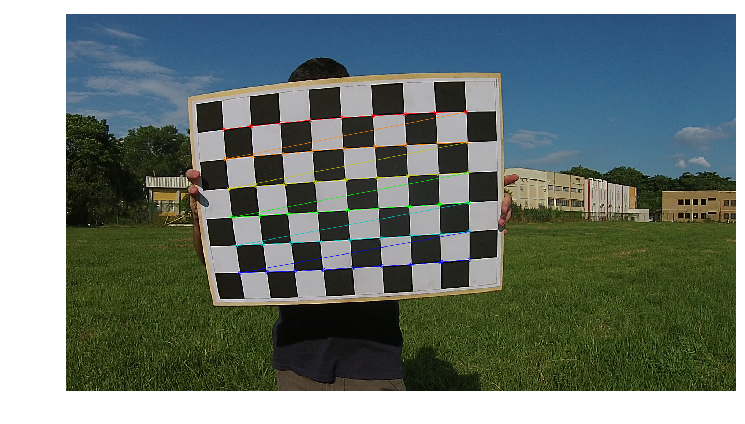

Searching for chessboard in frame 960...


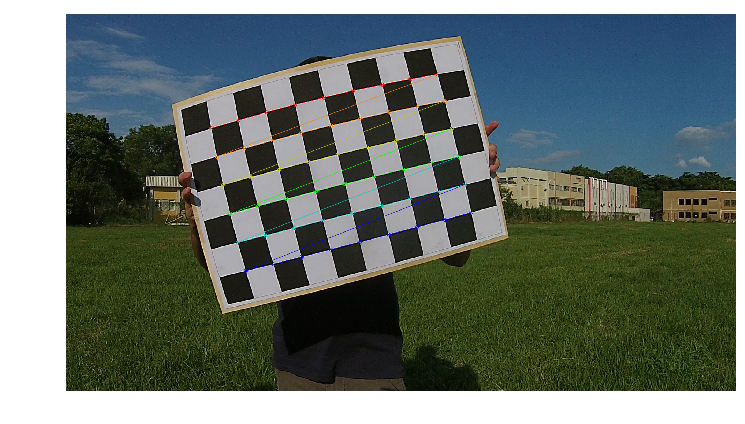

Searching for chessboard in frame 990...


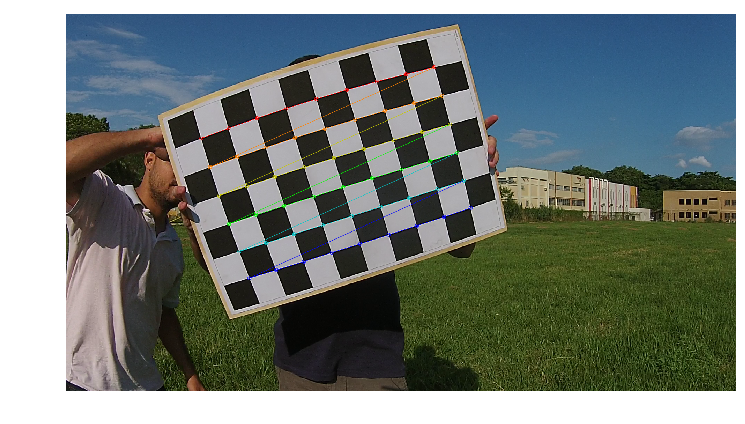

video capture failed!
computing cam params...
Done!


In [5]:
videos_path = '../../../Public/cam_calibration/DJI2_cam/'
video = videos_path+'DJI00964.MP4'
ret, mtx, dist, rvecs, tvecs = calibration_from_vid(video, frame_step=30, debug=True)

printing rms and the camera matrix

In [6]:
print('rms:', ret)
print('matrix:\n', mtx)

rms: 0.8814783458721025
matrix:
 [[1.20771987e+03 0.00000000e+00 9.16488429e+02]
 [0.00000000e+00 1.20277841e+03 5.78780940e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


## Extracting camera params from all calibration videos

In [7]:
videos = glob.glob(videos_path+'DJI009*.MP4')
videos

['../../../Public/cam_calibration/DJI2_cam/DJI00954.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00957.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00964.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00968.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00965.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00967.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00969.MP4',
 '../../../Public/cam_calibration/DJI2_cam/DJI00974.MP4']

In [8]:
#Initializing dict to save
cam_params = ['video','ret','mtx','dist','rvecs','tvecs']
dict_calib = {k:[] for k in cam_params}

for video in videos:
    print(video)
    ret, mtx, dist, rvecs, tvecs = calibration_from_vid(video, frame_step=20)
    dict_calib['video'] += [video]
    dict_calib['ret'] += [ret]
    dict_calib['mtx'] +=  [mtx]
    dict_calib['dist'] += [dist]
    dict_calib['rvecs'] += [rvecs]
    dict_calib['tvecs'] += [tvecs]
    print('\n')

../../../Public/cam_calibration/DJI2_cam/DJI00954.MP4
Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00954.MP4 ...
video capture failed!
computing cam params...
Done!


../../../Public/cam_calibration/DJI2_cam/DJI00957.MP4
Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00957.MP4 ...
video capture failed!
computing cam params...
Done!


../../../Public/cam_calibration/DJI2_cam/DJI00964.MP4
Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00964.MP4 ...
video capture failed!
computing cam params...
Done!


../../../Public/cam_calibration/DJI2_cam/DJI00968.MP4
Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00968.MP4 ...
video capture failed!
computing cam params...
Done!


../../../Public/cam_calibration/DJI2_cam/DJI00965.MP4
Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00965.MP4 ...
video capture failed!
computing cam params...
Done!


../../../Public/cam_calibration/DJI2_cam/DJI00967.MP4
Calibrating video: ..

printing the matrices

In [9]:
for (rms, vid, dist, mtx) in zip(dict_calib['ret'],
                                 dict_calib['video'],
                                 dict_calib['dist'],
                                 dict_calib['mtx']):
    print('rms: ', rms)
    print('video: ', vid)
    print('distortion:', dist)
    print('matrix:\n', mtx)
    print('\n')

rms:  1.0544149929409976
video:  ../../../Public/cam_calibration/DJI2_cam/DJI00954.MP4
distortion: [[-0.40943309  0.2735333  -0.00141574 -0.00145987 -0.17063699]]
matrix:
 [[1.18922706e+03 0.00000000e+00 9.18007238e+02]
 [0.00000000e+00 1.18493569e+03 5.52619627e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


rms:  1.2328919590284084
video:  ../../../Public/cam_calibration/DJI2_cam/DJI00957.MP4
distortion: [[-3.90017433e-01 -1.98214497e-01  2.87047178e-03  4.05311981e-04
   3.46373535e+00]]
matrix:
 [[2.06785396e+03 0.00000000e+00 8.39057173e+02]
 [0.00000000e+00 2.07891787e+03 5.86128743e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


rms:  0.9497058002041439
video:  ../../../Public/cam_calibration/DJI2_cam/DJI00964.MP4
distortion: [[-3.88785561e-01  2.10934313e-01 -2.50561694e-03 -4.54965767e-05
  -7.01193334e-02]]
matrix:
 [[1.21348346e+03 0.00000000e+00 9.09769191e+02]
 [0.00000000e+00 1.20865532e+03 5.78786538e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]



## LARGE FOV

Let's check if the undistortion process works for large FOV videos

In [10]:
video_name = 'DJI00967.MP4'
video = videos_path + video_name
ret, mtx, dist, rvecs, tvecs = calibration_from_vid(video, frame_step=20)

Calibrating video: ../../../Public/cam_calibration/DJI2_cam/DJI00967.MP4 ...
video capture failed!
computing cam params...
Done!


In [11]:
print('rms: {}'.format(ret))
print('camera matrix: \n', mtx)
print('distortion coefficients: ', dist)

rms: 0.6998963702134755
camera matrix: 
 [[1.23710179e+03 0.00000000e+00 9.31993447e+02]
 [0.00000000e+00 1.23268946e+03 5.79621772e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
distortion coefficients:  [[-0.3928916   0.2071907   0.00057155 -0.00060494 -0.05567092]]


Let's extract a frame from the video to apply the undistortion

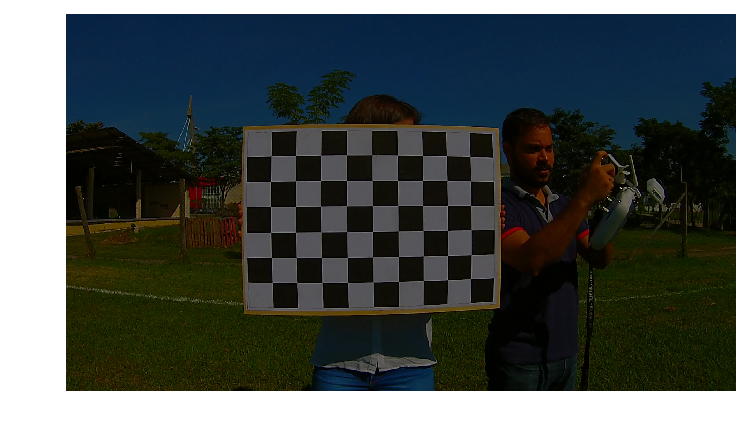

image size:  (1080, 1920, 3)


In [12]:
#load video
video_capture = cv2.VideoCapture(video)
#extract first frame
success,img = video_capture.read()
#displaying image
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()
print('image size: ', img.shape)

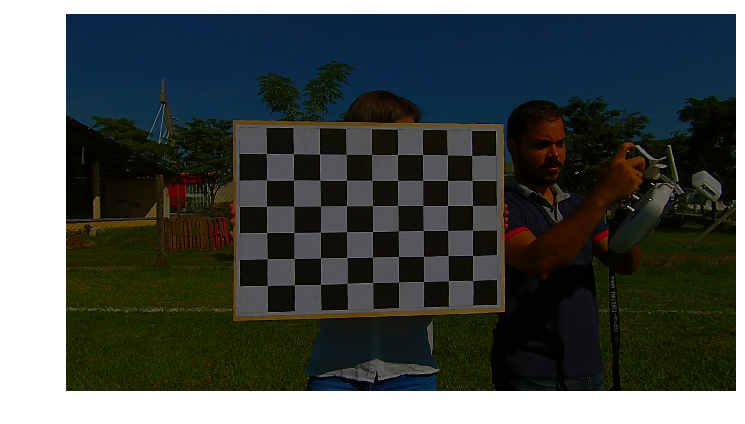

image size:  (1080, 1920, 3)


In [13]:
#undistort
dst = cv2.undistort(img, mtx, dist)
plt.imshow(cv2.cvtColor(dst,cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()
print('image size: ', dst.shape)

Putting both images together to better see the undistortion

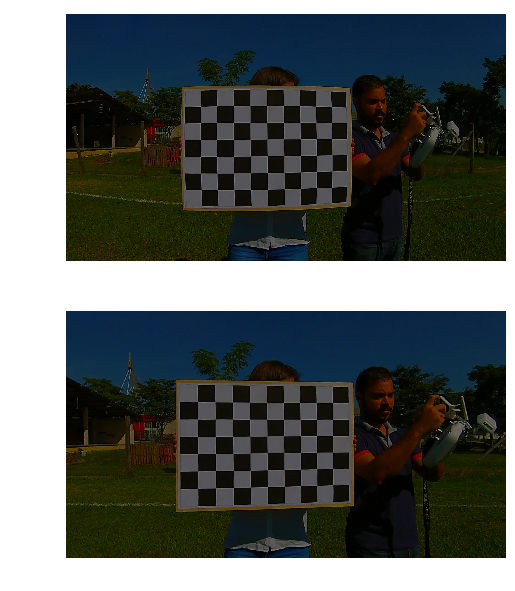

In [14]:
plt.subplot(2,1,1)
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(2,1,2)
plt.imshow(cv2.cvtColor(dst,cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()